In [1]:
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

In [2]:
data = pd.read_csv('../../data/atec_anti_fraud_train.csv')

In [3]:
print(data.columns)

Index(['id', 'label', 'date', 'f1', 'f2', 'f3', 'f4', 'f5', 'f6', 'f7',
       ...
       'f288', 'f289', 'f290', 'f291', 'f292', 'f293', 'f294', 'f295', 'f296',
       'f297'],
      dtype='object', length=300)


In [4]:
data1 = data[data['label']==1]

In [5]:
data1.to_csv('../../data/train_positive.csv', index=False)

In [6]:
data2 = data[data['label']==0]

In [7]:
data2.to_csv('../../data/train_negetive.csv', index=False)

In [8]:
data3 = data[data['label']==-1]

In [11]:
data3.to_csv('../../data/train_unkown.csv', index=False)

In [9]:
print(data1.shape, data2.shape, data3.shape)

(12122, 300) (977884, 300) (4725, 300)


正负样本的比例相差很大

In [22]:
a = data.max()
df_max = pd.DataFrame([a])
df_max.columns = data.columns
df_max.to_csv('../../data/data_max.csv', index=False)

In [11]:
#统计各个特征值缺失比例
miss_rate = []
for i in list(data.columns):
    miss_num = data[i].isnull().sum()
    rate = miss_num/data.shape[0]
    miss_rate.append(rate)
df_miss_rate = pd.DataFrame([miss_rate])
df_miss_rate.columns = data.columns
df_miss_rate.to_csv('../../data/data_miss_rate.csv', index=False)

In [8]:
# 离散特征分析
def cate_feat_analyze(df, feat_name):
    min_ = int(df[feat_name].min())
    max_ = int(df[feat_name].max())
    len_pos = df[df['label']==1].shape[0]
    len_neg = df[df['label']==-1].shape[0]
    pos = []
    neg = []
    subjects = []
    for i in range(min_, max_+1):
        num1 = df[(df['label']==1)&(df[feat_name]==i)].shape[0]/len_pos
        num2 = df[(df['label']==-1)&(df[feat_name]==i)].shape[0]/len_neg
        pos.append(num1)
        neg.append(num2)
        subjects.append('cate_val_{}'.format(i))
    # 加一个判断
    assert sum(pos)-1 < 1e-6 
    assert sum(neg)-1 < 1e-6
        
    scores = [pos, neg]
    # 画直方图
    font_size = 10 # 字体大小  
    fig_size = (8, 6) # 图表大小
    names = ('label=1', 'label==-1')  
    # 更新图表大小  
    mpl.rcParams['figure.figsize'] = fig_size  
    # 设置柱形图宽度  
    bar_width = 0.30  

    index = np.arange(len(scores[0]))  
    # 绘制正样本
    rects1 = plt.bar(index, scores[0], bar_width, color='#0072BC', label=names[0])  
    # 绘制负样本 
    rects2 = plt.bar(index + bar_width, scores[1], bar_width, color='#ED1C24', label=names[1])  
    # X轴标题  
    plt.xticks(index+bar_width/2, subjects)  
    # Y轴范围 
    plt.ylim(ymax=1, ymin=0)  
    # 图表标题  
    plt.title(feat_name)  
    # 图例显示在图表下方  
    plt.legend(loc='upper right', fontsize=15)  
    '''
    # 添加数据标签  
    def add_labels(rects):  
        for rect in rects:  
            height = rect.get_height()  
            plt.text(rect.get_x() + rect.get_width() / 2, height, height, ha='center', va='bottom')  
            # 柱形图边缘用白色填充，纯粹为了美观  
            rect.set_edgecolor('white') 
    add_labels(rects1)  
    add_labels(rects2) 
    '''
    plt.show()  
    return np.abs(np.asarray(pos)-np.asarray(neg))

In [9]:
# 连续特征分析
def conti_feat_analyze(df_pos, df_neg, feat_name):  
    dist1 = df_pos[feat_name].dropna()
    dist2 = df_neg[feat_name].dropna()
    fig=plt.figure(figsize=(8,4))  
    ax1=fig.add_subplot(1,1,1)
    sns.kdeplot(dist1, shade=True, label='label=1', ax=ax1)
    sns.kdeplot(dist2, shade=True, label='label=-1', ax=ax1)
    plt.title(feat_name)
    plt.show()

In [13]:
l = list(data.columns)
conti_feat = []
for i in ['id', 'label', 'date', 'f36', 'f37', 'f38', 'f39', 'f40', 'f41', 'f42', 'f43', 'f44', 'f45', 'f46', 'f47']:
    l.remove(i)
for i in l:
    if df_miss_rate.ix[0, i]>0.9:
        l.remove(i)
cate_feat = []
conti_feat = []
for i in l:
    if df_max.ix[0, i]<=4:
        cate_feat.append(i) 
    else:
        conti_feat.append(i)
print(cate_feat)
print(conti_feat)

['f1', 'f2', 'f3', 'f4', 'f6', 'f8', 'f9', 'f10', 'f11', 'f12', 'f13', 'f14', 'f15', 'f16', 'f17', 'f18', 'f19', 'f59', 'f60', 'f157', 'f166', 'f167', 'f168', 'f186', 'f194', 'f199', 'f254', 'f272']
['f5', 'f7', 'f20', 'f21', 'f22', 'f23', 'f24', 'f25', 'f26', 'f27', 'f28', 'f29', 'f30', 'f31', 'f32', 'f33', 'f34', 'f35', 'f48', 'f49', 'f50', 'f51', 'f52', 'f53', 'f54', 'f55', 'f56', 'f57', 'f58', 'f61', 'f62', 'f63', 'f64', 'f65', 'f66', 'f67', 'f68', 'f69', 'f70', 'f71', 'f72', 'f73', 'f74', 'f75', 'f76', 'f77', 'f78', 'f79', 'f80', 'f81', 'f82', 'f83', 'f84', 'f85', 'f86', 'f87', 'f88', 'f89', 'f90', 'f91', 'f92', 'f93', 'f94', 'f95', 'f96', 'f97', 'f98', 'f99', 'f100', 'f101', 'f102', 'f103', 'f104', 'f105', 'f106', 'f107', 'f108', 'f109', 'f110', 'f111', 'f112', 'f113', 'f114', 'f115', 'f116', 'f117', 'f118', 'f119', 'f120', 'f121', 'f122', 'f123', 'f124', 'f125', 'f126', 'f127', 'f128', 'f129', 'f130', 'f131', 'f132', 'f133', 'f134', 'f135', 'f136', 'f137', 'f138', 'f139', 'f140'

c:\d\python3.6\lib\site-packages\ipykernel_launcher.py:12: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
  if sys.path[0] == '':


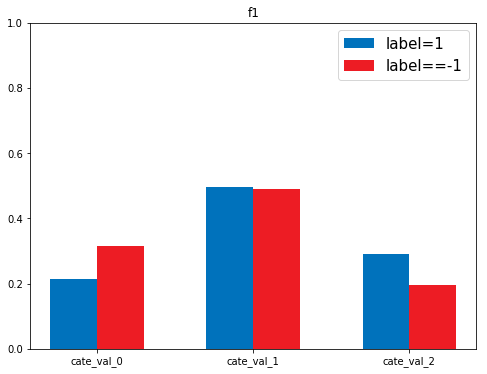

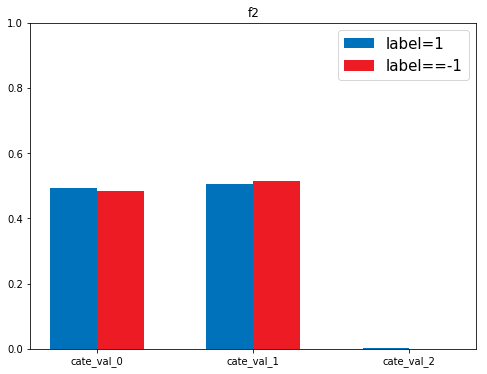

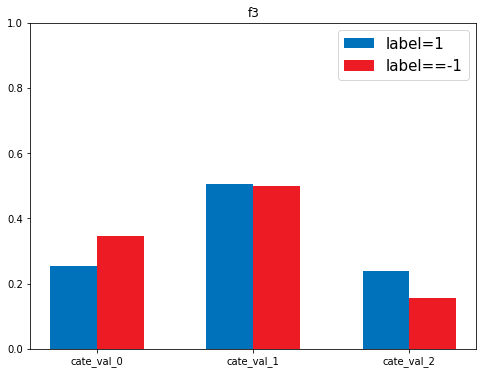

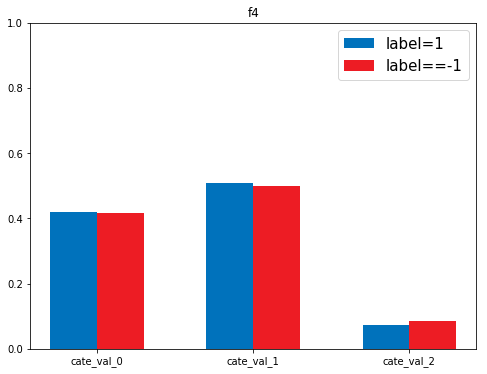

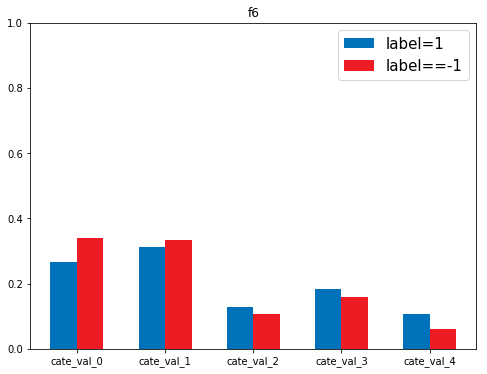

...

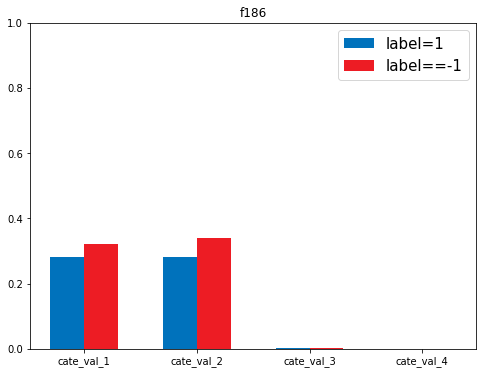

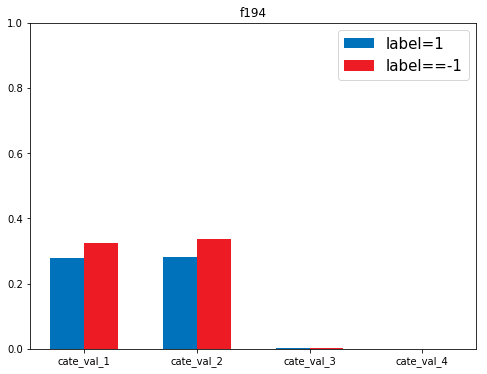

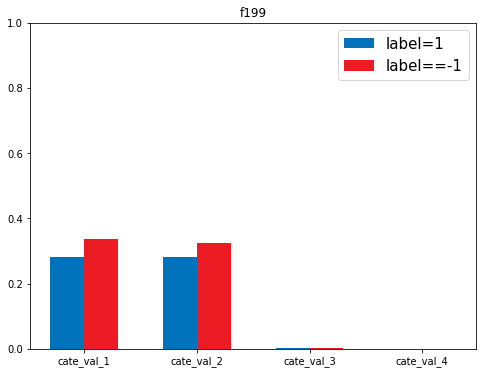

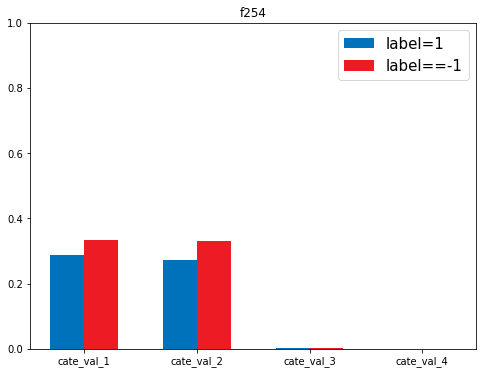

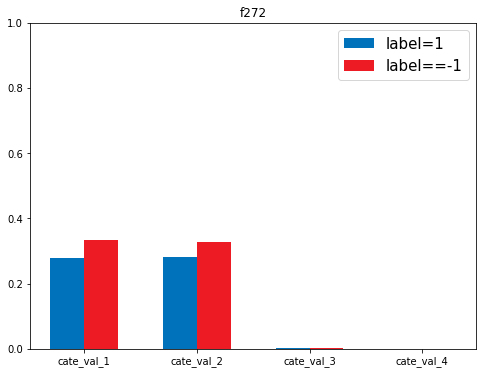

{'f1_0': 0.10070709689584462, 'f1_1': 0.004787482464433446, 'f1_2': 0.09591961443141117, 'f2_0': 0.008966791761710113, 'f2_1': 0.011854104086408968, 'f2_2': 0.0028873123246988945, 'f3_0': 0.09155740273707608, 'f3_1': 0.00633614688061146, 'f3_2': 0.08522125585646456, 'f4_0': 0.005072084600215243, 'f4_1': 0.007777821425734299, 'f4_2': 0.012849906025949584, 'f6_0': 0.07519050150629097, 'f6_1': 0.020065349720522097, 'f6_2': 0.02201416114301777, 'f6_3': 0.026057830050570524, 'f6_4': 0.04718386003322483, 'f8_0': 0.010428544366838377, 'f8_1': 4.151793625484235e-05, 'f8_2': 0.01038702643058359, 'f9_0': 0.09086294628944358, 'f9_1': 0.0010422608244750053, 'f9_2': 0.0898206854649686, 'f10_0': 0.05905332820033363, 'f10_1': 0.000500642061440626, 'f10_2': 0.058552686138893056, 'f11_0': 0.08342088240454842, 'f11_1': 0.005661960543993205, 'f11_2': 0.07775892186055525, 'f12_0': 0.050559383481343534, 'f12_1': 0.0020822694143928233, 'f12_2': 0.048477114066950724, 'f13_0': 0.011892671420802081, 'f13_1': 0

In [76]:
diff_cate_feat = {}
for i in cate_feat:
    diff_abs = cate_feat_analyze(data, i)
    size = len(diff_abs)
    for j in range(size):
        diff_cate_feat['{0}_{1}'.format(i, j)] = diff_abs[j]
print(diff_cate_feat)

['f1_0', 'f1_2', 'f2_1', 'f3_0', 'f3_2', 'f4_2', 'f6_0', 'f6_1', 'f6_2', 'f6_3', 
 'f6_4', 'f9_0', 'f9_2', 'f10_0', 'f10_2', 'f11_0', 'f11_2', 'f12_0', 'f12_2', 'f13_0', 
 'f14_0', 'f14_1', 'f14_2', 'f15_0', 'f15_1', 'f15_2', 'f16_0', 'f16_2', 'f17_2', 
 'f18_0', 'f18_2', 'f19_0', 'f19_2', 'f59_0', 'f59_1', 'f60_0', 'f60_1', 'f157_0', 
 'f157_1', 'f166_0', 'f166_1', 'f167_0', 'f167_1', 'f168_0', 'f168_1', 'f186_0', 
 'f186_1', 'f194_0', 'f194_1', 'f199_0', 'f199_1', 'f254_0', 'f254_1', 'f272_0', 'f272_1'] <br>
 先选择这些离散特征 阈值为0.011854104086408968

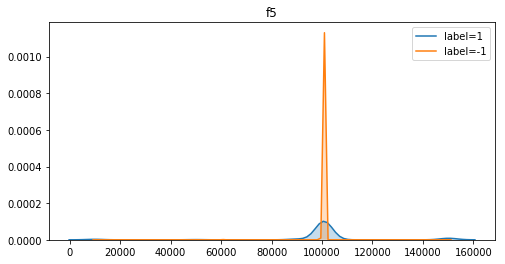

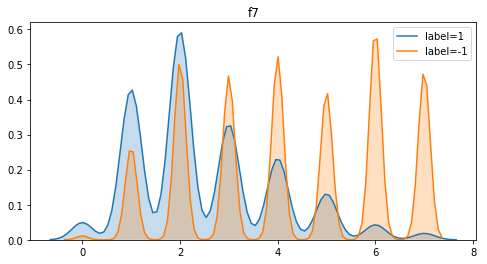

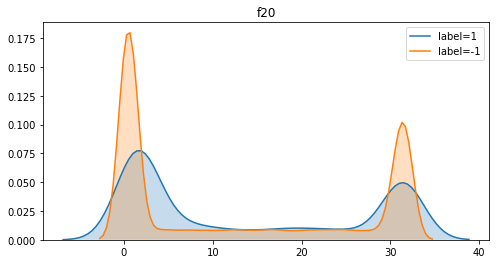

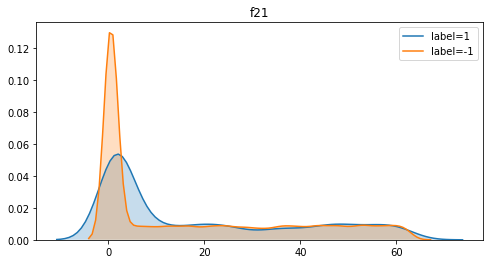

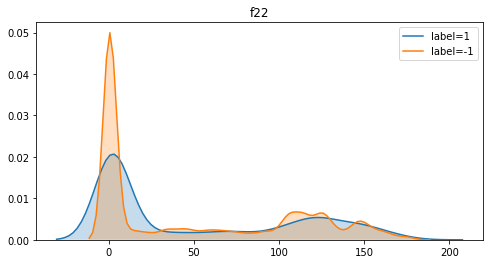

...

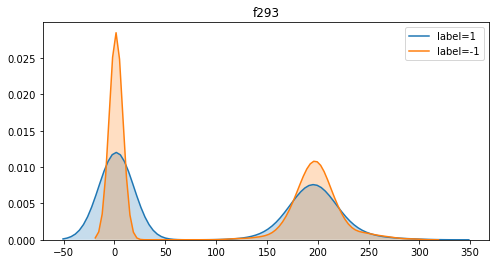

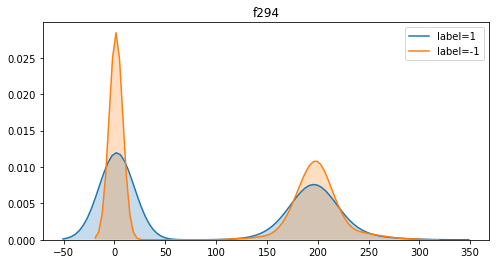

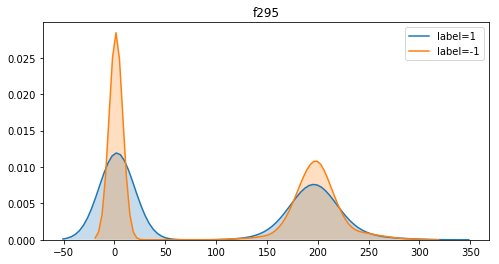

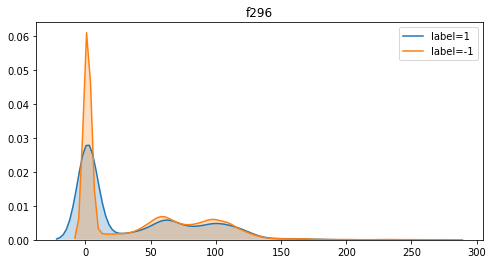

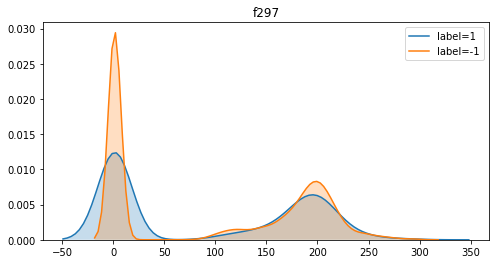

In [79]:
for i in conti_feat:
    conti_feat_analyze(data1, data2, i)

f55 f58 f72 f104 <br>
f57 f62 f63 f74 f84 f109 f208 f239  
分别区别不大

In [90]:
# spearman相关系数  pearson相关系数   不适用分类特征和连续特征
print(data['label'].corr(data['f7'], method='spearman'))
print(data['label'].corr(data['f7']))

-0.06282326821915774
-0.06388986048868339


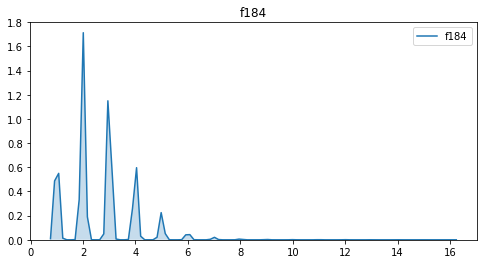

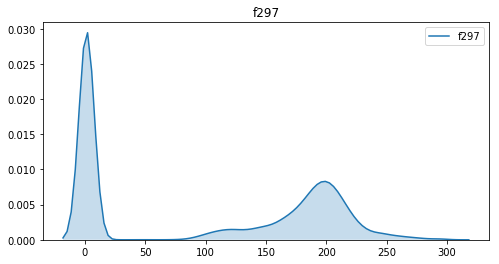

In [86]:
# 计算特征为连续值列 的相关系数  Pearson相关系数适用于大体服从正态分布的连续变量
# 很多特征的分布不服从正态分布 如下所示
def conti_feat_analyze(df, feat_name):  
    dist = df[feat_name].dropna()
    fig=plt.figure(figsize=(8,4))  
    ax1=fig.add_subplot(1,1,1)
    sns.kdeplot(dist, shade=True, ax=ax1)
    plt.title(feat_name)
    plt.show()
conti_feat_analyze(data, 'f184')
conti_feat_analyze(data, 'f297')

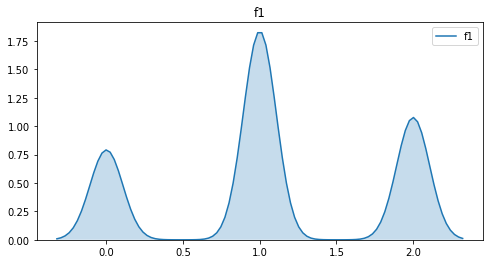

In [87]:
# 离散特征时的概率密度图   
conti_feat_analyze(data1,  'f1')

In [16]:
# 实验异常样本的分布随时间的变化幅度
# 离散特征分析
def pos_cate_feat_analyze(df, feat_name, mid):
    min_ = int(df[feat_name].min())
    max_ = int(df[feat_name].max())
    len_pos = df[df['date']<mid].shape[0]
    len_neg = df[df['date']>mid].shape[0]
    pos = []
    neg = []
    subjects = []
    for i in range(min_, max_+1):
        num1 = df[(df['date']<mid)&(df[feat_name]==i)].shape[0]/len_pos
        num2 = df[(df['date']>mid)&(df[feat_name]==i)].shape[0]/len_neg
        pos.append(num1)
        neg.append(num2)
        subjects.append('cate_val_{}'.format(i))
    # 加一个判断
    assert sum(pos)-1 < 1e-6 
    assert sum(neg)-1 < 1e-6
        
    scores = [pos, neg]
    # 画直方图
    font_size = 10 # 字体大小  
    fig_size = (8, 6) # 图表大小
    names = ('20170905-{}'.format(mid), '{}-20171105'.format(mid))  
    # 更新图表大小  
    mpl.rcParams['figure.figsize'] = fig_size  
    # 设置柱形图宽度  
    bar_width = 0.30  

    index = np.arange(len(scores[0]))  
    # 绘制正样本
    rects1 = plt.bar(index, scores[0], bar_width, color='#0072BC', label=names[0])  
    # 绘制负样本 
    rects2 = plt.bar(index + bar_width, scores[1], bar_width, color='#ED1C24', label=names[1])  
    # X轴标题  
    plt.xticks(index+bar_width/2, subjects)  
    # Y轴范围 
    plt.ylim(ymax=1, ymin=0)  
    # 图表标题  
    plt.title(feat_name)  
    # 图例显示在图表下方  
    plt.legend(loc='upper right', fontsize=15)  
    '''
    # 添加数据标签  
    def add_labels(rects):  
        for rect in rects:  
            height = rect.get_height()  
            plt.text(rect.get_x() + rect.get_width() / 2, height, height, ha='center', va='bottom')  
            # 柱形图边缘用白色填充，纯粹为了美观  
            rect.set_edgecolor('white') 
    add_labels(rects1)  
    add_labels(rects2) 
    '''
    plt.show()  
    return np.abs(np.asarray(pos)-np.asarray(neg))

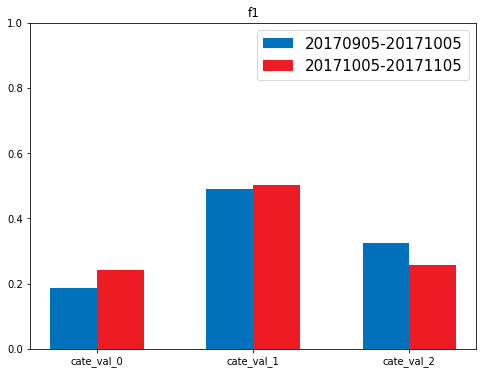

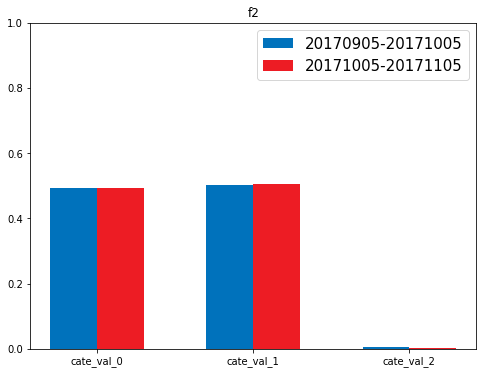

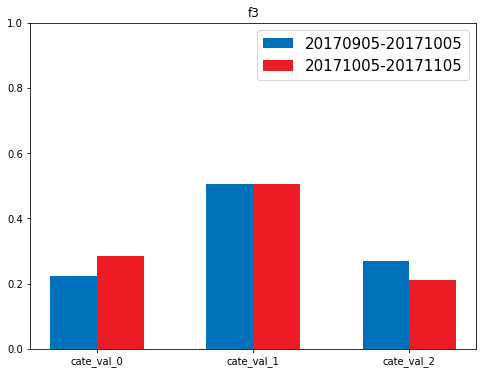

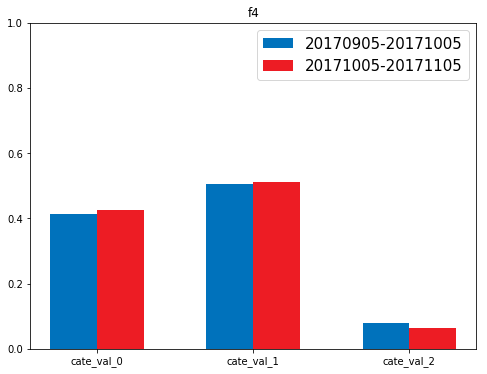

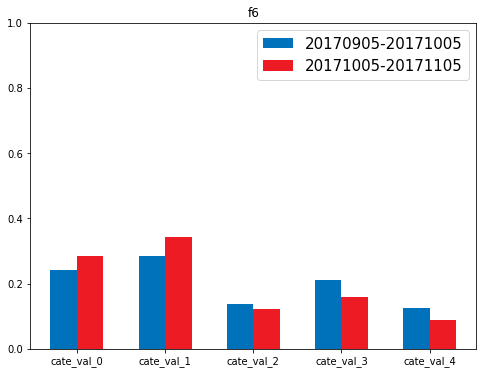

...

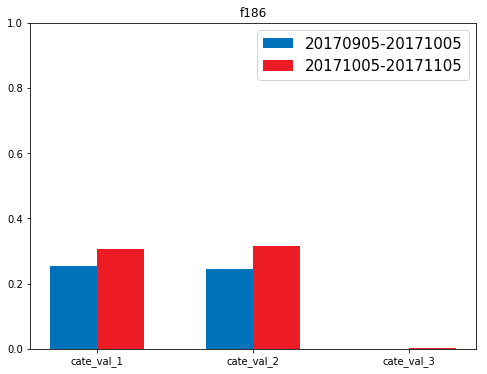

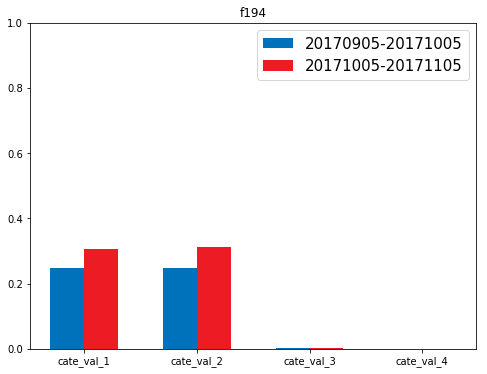

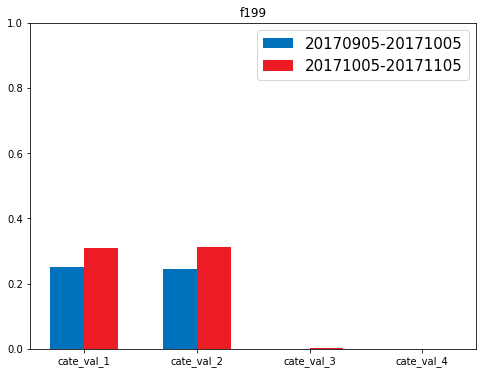

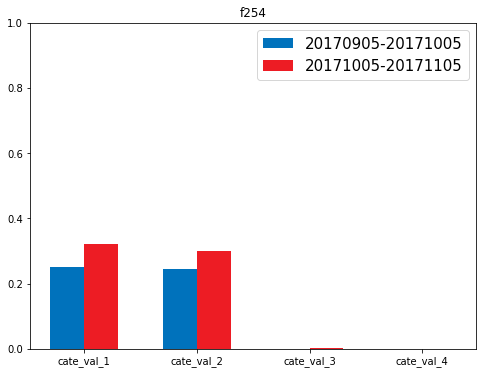

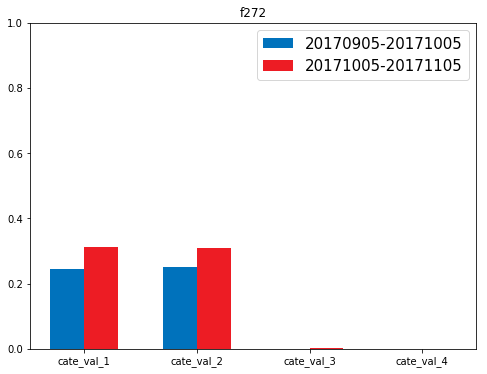

{'f1_0': 0.055885837570744695, 'f1_1': 0.011651166423881143, 'f1_2': 0.06753700399462581, 'f2_0': 0.00209836233538524, 'f2_1': 0.0052526164237012285, 'f2_2': 0.003154254088315934, 'f3_0': 0.06009576019086074, 'f3_1': 0.0006464204915211935, 'f3_2': 0.05944933969933955, 'f4_0': 0.010041351435413681, 'f4_1': 0.0053196664707994, 'f4_2': 0.015361017906213137, 'f6_0': 0.042885048288729605, 'f6_1': 0.05798668324120765, 'f6_2': 0.013295748103436533, 'f6_3': 0.0525184910106479, 'f6_4': 0.035057492415852806, 'f8_0': 0.0058667814618534216, 'f8_1': 0.015396984410878, 'f8_2': 0.009530202949024569, 'f9_0': 0.09501569258499304, 'f9_1': 0.004180596944085957, 'f9_2': 0.09083509564090708, 'f10_0': 0.060540946833163245, 'f10_1': 0.015537641625785303, 'f10_2': 0.04500330520737786, 'f11_0': 0.03578591877022125, 'f11_1': 0.0073486628398566345, 'f11_2': 0.04313458161007783, 'f12_0': 0.0008050749100816379, 'f12_1': 0.004287073423373089, 'f12_2': 0.003481998513291465, 'f13_0': 0.008708804993769248, 'f13_1': 0.

In [18]:
cate_feat = ['f1', 'f2', 'f3', 'f4', 'f6', 'f8', 'f9', 'f10', 'f11', 'f12', 'f13', 'f14', 'f15', 'f16', 'f17', 'f18', 'f19', 
 'f59', 'f60', 'f157', 'f166', 'f167', 'f168', 'f186', 'f194', 'f199', 'f254', 'f272']
diff_cate_feat = {}
for i in cate_feat:
    diff_abs = pos_cate_feat_analyze(data1, i, 20171005)
    size = len(diff_abs)
    for j in range(size):
        diff_cate_feat['{0}_{1}'.format(i, j)] = diff_abs[j]
print(diff_cate_feat)

In [23]:
# 正样本连续特征分布的变化
def pos_conti_feat_analyze(df, feat_name, mid):  
    dist1 = df[df['date']<mid][feat_name].dropna()
    dist2 = df[df['date']>=mid][feat_name].dropna()
    fig=plt.figure(figsize=(8,4))  
    ax1=fig.add_subplot(1,1,1)
    sns.kdeplot(dist1, shade=True, label='20170905-20171005', ax=ax1)
    sns.kdeplot(dist2, shade=True, label='20171005-20171105', ax=ax1)
    plt.title(feat_name)
    plt.show()

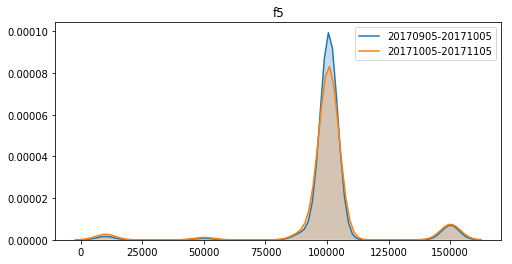

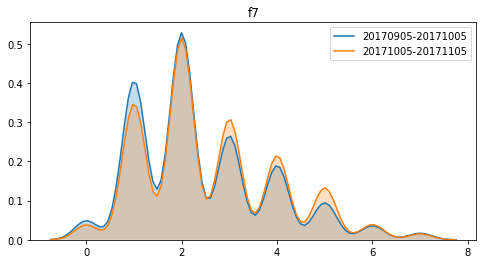

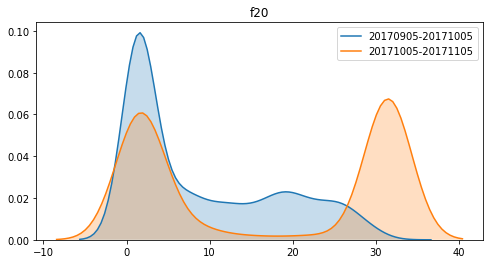

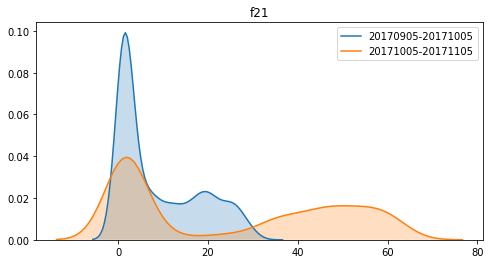

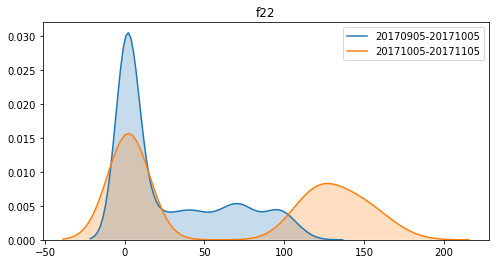

...

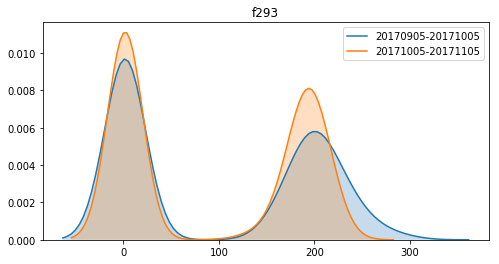

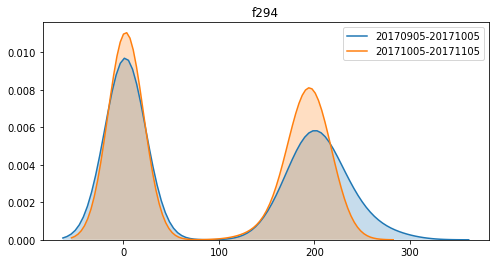

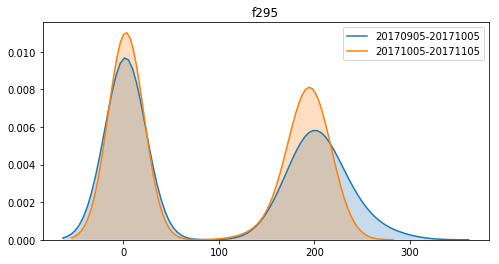

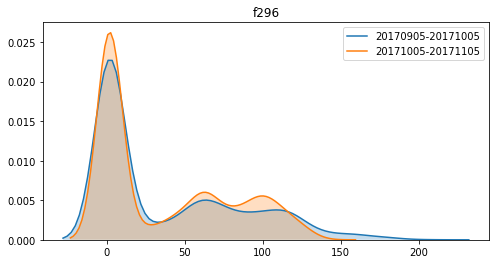

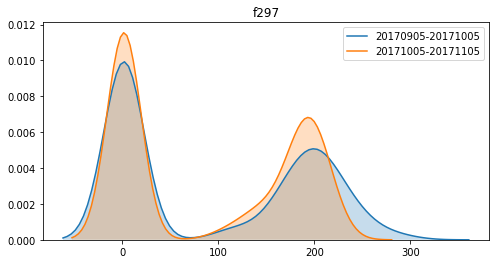

In [24]:
for i in conti_feat:
    pos_conti_feat_analyze(data1, i, 20171005)

初赛不考虑分布的变化

线下分值0.66， 线上分值0.278 
所以随着时间的迁移，数据分布发生了变化
从上面的图可以看出有些特征分布随时间变化的特别明显

'f20', 'f21', 'f22', 'f23', 'f64', 'f99', 'f100', 'f101', 'f124', 'f130', 'f134', 'f142', 'f143', 'f148', 'f281', 'f282',
'f283'， 'f284', 'f285', 'f287', 'f293', 'f294', ''f295', 'f297' 分布变化明显

In [3]:
data = data[data['label']!=-1]

In [4]:
test = pd.read_csv('../../data/atec_anti_fraud_test_a.csv')

In [8]:
def conti_feat_analyze(df, test, feat_name): 
    dist1 = df[feat_name].dropna()
    dist2 = test[feat_name].dropna()
    fig=plt.figure(figsize=(8,4))  
    ax1=fig.add_subplot(1,1,1)
    sns.kdeplot(dist1, shade=True, label='train_set', ax=ax1)
    sns.kdeplot(dist2, shade=True, label='test_set', ax=ax1)
    plt.title(feat_name)
    plt.show()

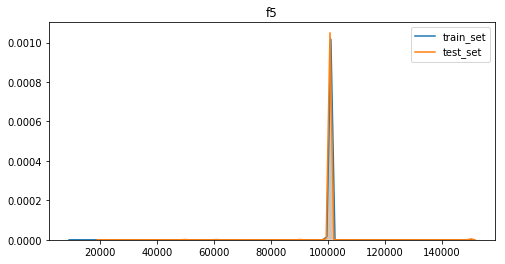

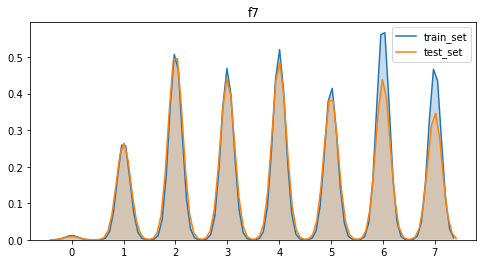

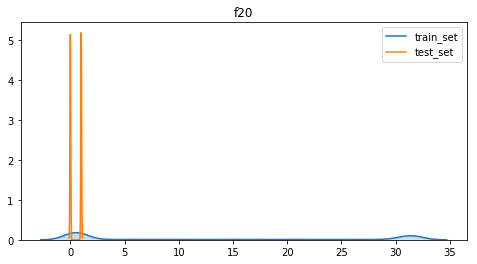

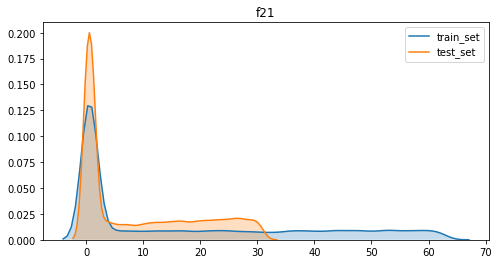

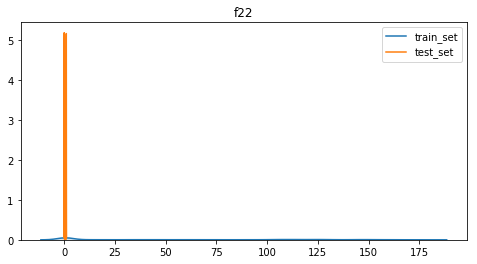

...

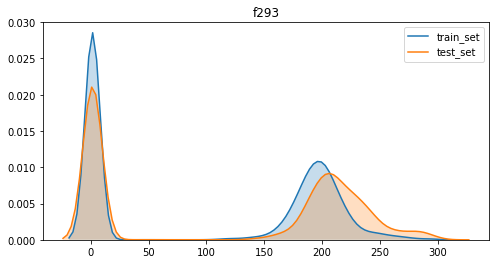

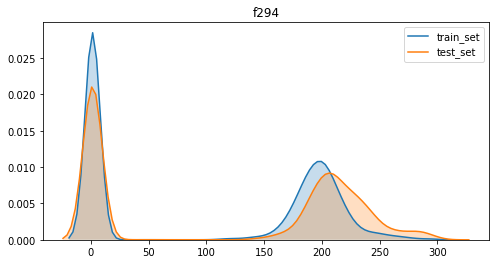

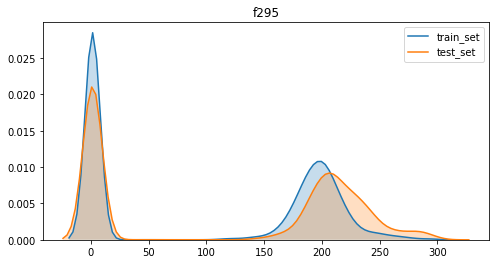

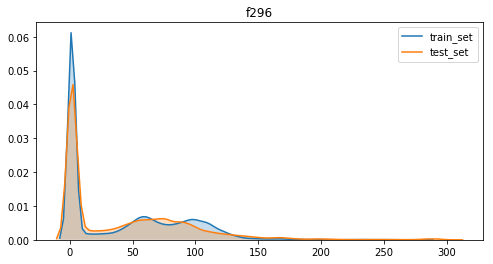

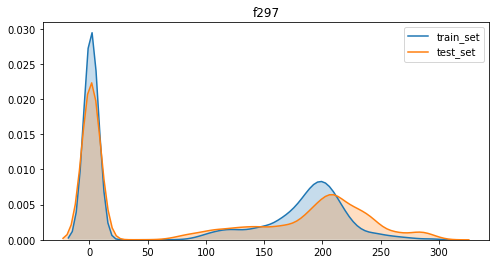

In [9]:
# 看一下训练集和测试集上的分布差异
cat_feat = ['f5', 'f7', 'f20', 'f21', 'f22', 'f23', 'f24', 'f25', 'f26', 'f27', 'f28', 'f29', 'f30', 'f31', 'f32', 'f33', 
            'f34', 'f35', 'f48', 'f49', 'f50', 'f51', 'f52', 'f53', 'f54', 'f55', 'f56', 'f57', 'f58', 'f61', 'f62', 'f63',
            'f64', 'f65', 'f66', 'f67', 'f68', 'f69', 'f70', 'f71', 'f72', 'f73', 'f74', 'f75', 'f76', 'f77', 'f78', 'f79', 
            'f80', 'f81', 'f82', 'f83', 'f84', 'f85', 'f86', 'f87', 'f88', 'f89', 'f90', 'f91', 'f92', 'f93', 'f94', 'f95', 
            'f96', 'f97', 'f98', 'f99', 'f100', 'f101', 'f102', 'f103', 'f104', 'f105', 'f106', 'f107', 'f108', 'f109', 'f110',
            'f111', 'f112', 'f113', 'f114', 'f115', 'f116', 'f117', 'f118', 'f119', 'f120', 'f121', 'f122', 'f123', 'f124', 
            'f125', 'f126', 'f127', 'f128', 'f129', 'f130', 'f131', 'f132', 'f133', 'f134', 'f135', 'f136', 'f137', 'f138', 
            'f139', 'f140', 'f141', 'f142', 'f143', 'f144', 'f145', 'f146', 'f147', 'f148', 'f149', 'f150', 'f151', 'f152', 
            'f153', 'f154', 'f155', 'f156', 'f158', 'f159', 'f160', 'f161', 'f162', 'f163', 'f164', 'f165', 'f169', 'f170', 
            'f171', 'f172', 'f173', 'f174', 'f175', 'f176', 'f177', 'f178', 'f179', 'f180', 'f181', 'f182', 'f183', 'f184', 
            'f185', 'f187', 'f188', 'f189', 'f190', 'f191', 'f192', 'f193', 'f195', 'f196', 'f197', 'f198', 'f200', 'f201', 
            'f202', 'f203', 'f204', 'f205', 'f206', 'f207', 'f208', 'f209', 'f210', 'f211', 'f212', 'f213', 'f214', 'f215', 
            'f216', 'f217', 'f218', 'f219', 'f220', 'f221', 'f222', 'f223', 'f224', 'f225', 'f226', 'f227', 'f228', 'f229', 
            'f230', 'f231', 'f232', 'f233', 'f234', 'f235', 'f236', 'f237', 'f238', 'f239', 'f240', 'f241', 'f242', 'f243', 
            'f244', 'f245', 'f246', 'f247', 'f248', 'f249', 'f250', 'f251', 'f252', 'f253', 'f255', 'f256', 'f257', 'f258', 
            'f259', 'f260', 'f261', 'f262', 'f263', 'f264', 'f265', 'f266', 'f267', 'f268', 'f269', 'f270', 'f271', 'f273', 
            'f274', 'f275', 'f276', 'f277', 'f278', 'f279', 'f280', 'f281', 'f282', 'f283', 'f284', 'f285', 'f286', 'f287', 
            'f288', 'f289', 'f290', 'f291', 'f292', 'f293', 'f294', 'f295', 'f296', 'f297']

for i in cat_feat:
    conti_feat_analyze(data, test, i)

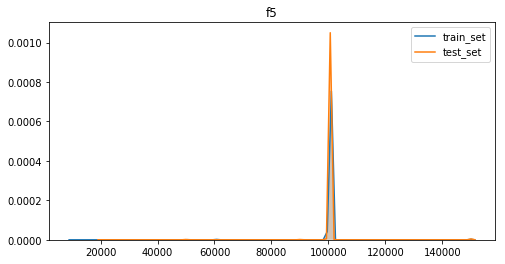

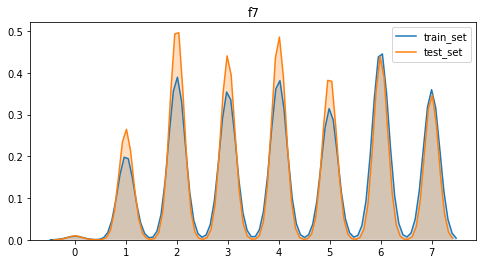

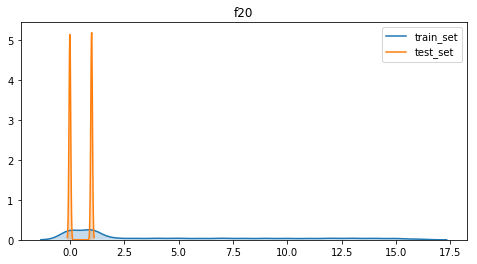

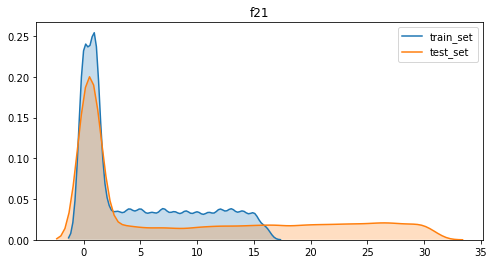

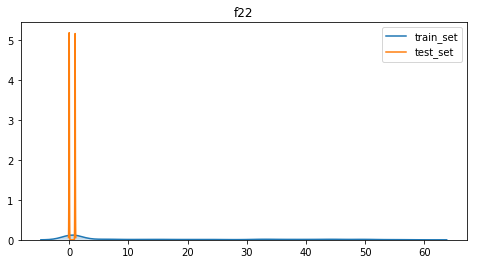

...

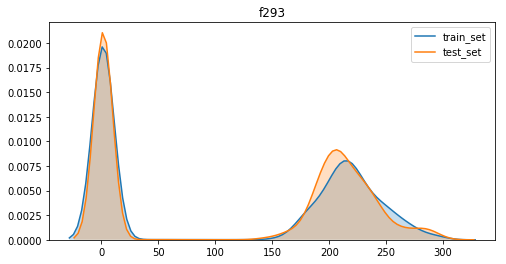

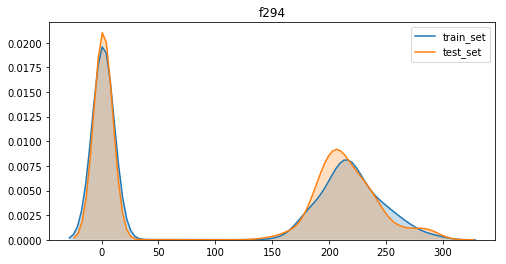

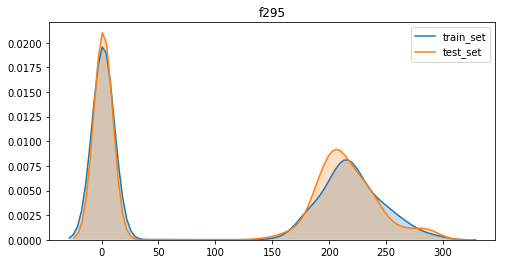

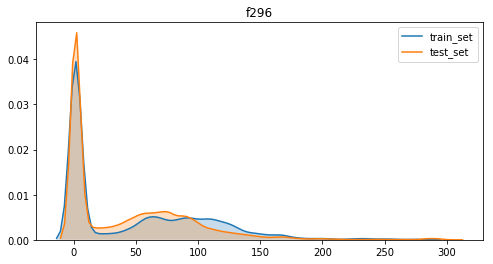

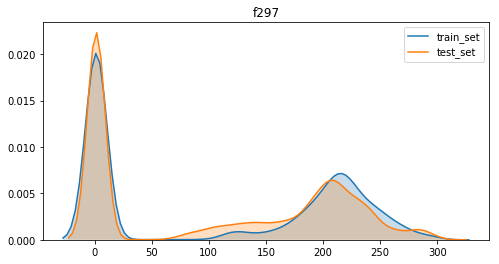

In [10]:
# 按时间划分  数据分布的差异
data1 = data[data['date']<20170920]
for i in cat_feat:
    conti_feat_analyze(data1, test, i)